In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import leastsq
import scienceplots
from photometric_models import HG, HG12, HG1G2
from db import query

plt.style.use('science')

filters = ['g', 'r', 'i', 'z']
filter_colors = {'g': '#008060', 'r': '#ff4000', 'i': '#850000', 'z': '#6600cc'}
linestyles = {'g': "--", "r":"-.", "i":":", "z":"-"}


In [445]:
def weighted_dev(params, mag, phase, mag_err, model):
    """
    Compute weighted deviation for a given model.
    
    Parameters
    ----------
    params: list
        phase curve parameters
    mag: ndarray
        reduced magnitude
    phase: ndarray
        phase angle in radians
    mag_err: ndarray
        uncertainty in magnitude
    model: function
        phase curve model function
    

    Returns
    -------
    sol: tuple
        best-fit solution
    """

    pred = model(phase, params)

    return (mag - pred)/mag_err

def fitPhaseCurve(mag, phase, sigma, model=HG12, params=[0.1]):
    """
    Fit phase curve for given observations to a designated model.

    Parameters
    ----------
    mag: ndarray
        reduced magnitude
    phase: ndarray
        phase angle in degrees
    sigma: ndarray
        uncertainty in magnitude
    model: function (default=HG12_model)
        phase curve model function
    params: list (default=[0.1])
        phase curve parameters

    Returns
    -------
    sol: tuple
        best-fit solution
    """

    phase = np.deg2rad(phase)
    sol = leastsq(weighted_dev, [mag[0]] + params, (mag, phase, sigma, model),
                  full_output=True)
    
    return sol

def fitAllPhaseCurveModels(reducedMag, magSigma, phaseAngle, verbose=False):
    """
    Fit phase curves for given observations to three different models,
    the HG (sol_HG), HG12 (sol_HG12) and HG1G2 (sol_HG1G2), and 
    store the resulting solutions in a dictionary of dictionaries. 
    Save np.nan values when the fit is not converged.

    Parameters
    ----------
    reducedMag: ndarray
        reduced magnitude
    magSigma: ndarray
        uncertainty in magnitude
    phaseAngle: ndarray
        phase angle in degrees

    Returns
    -------
    solutions: dict
        Best-fit solutions for each model
    """
    solutions = {}

    sol_HG = fitPhaseCurve(reducedMag, phaseAngle, magSigma, model=HG)
    
    solutions['HG'] = {}
    try:
        solutions['HG']['chi2'] = np.sum(sol_HG[2]['fvec']**2)
        solutions['HG']['H'] = sol_HG[0][0]
        solutions['HG']['G'] = sol_HG[0][1]
        solutions['HG']['H_err'] = np.sqrt(sol_HG[1][0, 0])
        solutions['HG']['G_err'] = np.sqrt(sol_HG[1][1, 1])
        solutions['HG']['cov'] = sol_HG[1]
    except TypeError:
        if verbose:
            print('HG model is not converging')
        solutions['HG']['chi2'] = np.nan
        solutions['HG']['H'] = np.nan
        solutions['HG']['G'] = np.nan
        solutions['HG']['H_err'] = np.nan
        solutions['HG']['G_err'] = np.nan
        solutions['HG']['cov'] = np.nan

    sol_HG12 = fitPhaseCurve(reducedMag, phaseAngle,
                             magSigma, model=HG12)

    solutions['HG12'] = {}
    try:
        solutions['HG12']['chi2'] = np.sum(sol_HG12[2]['fvec']**2)
        solutions['HG12']['H'] = sol_HG12[0][0]
        solutions['HG12']['G12'] = sol_HG12[0][1]
        solutions['HG12']['H_err'] = np.sqrt(sol_HG12[1][0, 0])
        solutions['HG12']['G12_err'] = np.sqrt(sol_HG12[1][1, 1])
        solutions['HG12']['cov'] = sol_HG12[1]
    except TypeError:
        if verbose:
            print('HG12 model is not converging')
        solutions['HG12']['chi2'] = np.nan
        solutions['HG12']['H'] = np.nan
        solutions['HG12']['G12'] = np.nan
        solutions['HG12']['H_err'] = np.nan
        solutions['HG12']['G12_err'] = np.nan
        solutions['HG12']['cov'] = np.nan

    sol_HG1G2 = fitPhaseCurve(reducedMag, phaseAngle, magSigma,
                              model=HG1G2, params=[0.1, 0.1])

    solutions['HG1G2'] = {}
    try:
        solutions['HG1G2']['chi2'] = np.sum(sol_HG1G2[2]['fvec']**2)
        solutions['HG1G2']['H'] = sol_HG1G2[0][0]
        solutions['HG1G2']['G1'] = sol_HG1G2[0][1]
        solutions['HG1G2']['G2'] = sol_HG1G2[0][2]
        solutions['HG1G2']['H_err'] = np.sqrt(sol_HG1G2[1][0, 0])
        solutions['HG1G2']['G1_err'] = np.sqrt(sol_HG1G2[1][1, 1])
        solutions['HG1G2']['G2_err'] = np.sqrt(sol_HG1G2[1][2, 2])
        solutions['HG1G2']['cov'] = sol_HG1G2[1]
    except TypeError:
        if verbose:
            print('HG1G2 model is not converging')
        solutions['HG1G2']['chi2'] = np.nan
        solutions['HG1G2']['H'] = np.nan
        solutions['HG1G2']['G1'] = np.nan
        solutions['HG1G2']['G2'] = np.nan
        solutions['HG1G2']['H_err'] = np.nan
        solutions['HG1G2']['G1_err'] = np.nan
        solutions['HG1G2']['G2_err'] = np.nan
        solutions['HG1G2']['cov'] = np.nan

    return solutions

def reduced_magnitude(m, hd, td):
    return m - 5.0*np.log10(hd*td)

In [446]:
nobs_thrh = '2000'
min_a = '2.0'
max_a = '3.2'
min_q = '1.666'

stmt = """
SELECT
    mpc.ssObjectId, mpc.mpcG, mpc.mpcH,
    mpc.q/(1-mpc.e) as a,
    sso.arc, sso.numObs,
    sso.g_H, sso.g_Herr, sso.g_G12, sso.g_G12err, sso.g_H_gG12_Cov,
    sso.r_H, sso.r_Herr, sso.r_G12, sso.r_G12err, sso.r_H_rG12_Cov,
    sso.i_H, sso.i_Herr, sso.i_G12, sso.i_G12err, sso.i_H_iG12_Cov,
    sso.z_H, sso.z_Herr, sso.z_G12, sso.z_G12err, sso.z_H_zG12_Cov
FROM
    dp03_catalogs_10yr.MPCORB as mpc
INNER JOIN dp03_catalogs_10yr.SSObject as sso
ON mpc.ssObjectId = sso.ssObjectId
WHERE sso.numObs > {} AND mpc.q/(1-mpc.e) > {} AND
mpc.q/(1-mpc.e) < {} AND mpc.q > {} ORDER by sso.ssObjectId
""".format(nobs_thrh, min_a, max_a, min_q)

uniqueObj = query(stmt).to_table()

In [447]:
stmt = """
SELECT
    dia.ssObjectId, dia.diaSourceId, dia.mag,
    dia.magErr, dia.band, dia.midPointMjdTai,
    sss.phaseAngle, sss.topocentricDist, sss.heliocentricDist
FROM
    dp03_catalogs_10yr.DiaSource as dia
INNER JOIN
    dp03_catalogs_10yr.SSSource as sss
ON
    dia.diaSourceId = sss.diaSourceId
WHERE
    dia.ssObjectId
    IN {}
ORDER by dia.ssObjectId
""".format(tuple(uniqueObj['ssObjectId']))

indivObs = query(stmt).to_table()
indivObs

ssObjectId,diaSourceId,mag,magErr,band,midPointMjdTai,phaseAngle,topocentricDist,heliocentricDist
,,,,,d,deg,AU,AU
int64,int64,float32,float32,str1,float64,float32,float32,float32
-9217466392671047318,5074726492115737,20.055,0.012,r,61021.35247,17.301477,2.711414,3.1537251
-9217466392671047318,19481485662802488,19.669,0.007,i,61033.2511,15.801364,2.5499394,3.1503248
-9217466392671047318,39913165364548592,20.21,0.009,r,61010.34128,18.036163,2.8695178,3.1563327
-9217466392671047318,48327202766987632,19.45,0.01,z,61049.34712,12.501292,2.3604758,3.14477
-9217466392671047318,48371439483286632,19.711,0.008,i,61031.33981,16.094881,2.5749133,3.1509116
-9217466392671047318,62341640397910521,20.195,0.008,g,61051.17905,12.03446,2.3417952,3.144068
-9217466392671047318,73744426738833766,20.075,0.016,i,61005.35388,18.184,2.9424236,3.1573431
-9217466392671047318,75023334125204409,20.044,0.014,r,61021.3483,17.301888,2.711473,3.1537263


In [448]:
indivObs.add_column(reduced_magnitude(indivObs['mag'], indivObs['topocentricDist'], indivObs['heliocentricDist']), name='reducedMag')

In [450]:
fitted_array = []

for iobj in uniqueObj['ssObjectId']:
    idx = indivObs['ssObjectId'] == iobj
    tmp = indivObs[idx]
    filts_tmp = np.unique(tmp['band'])
    for ifilt in filts_tmp:
        idx_filt = tmp['band'] == ifilt
        nobs_ifilt = len(tmp[idx_filt])

        if nobs_ifilt > 3:
            x_fitted = fitAllPhaseCurveModels(tmp['reducedMag'][idx_filt],
                                              tmp['magErr'][idx_filt],
                                              tmp['phaseAngle'][idx_filt])
            fitted_array.append([iobj, ifilt, x_fitted])

results = pd.DataFrame(fitted_array)
results.columns = ['ssObjectId', 'fname', 'fit_param']

L = ['ssObjectId', 'fname']
results = results[L].join(pd.json_normalize(results.fit_param))

(array([15.16413179,  0.17803525]), array([[3.66809266e-06, 3.81000420e-06],
       [3.81000420e-06, 4.08296547e-06]]), {'fvec': array([-1.52111042e+00,  1.67160034e+00,  7.18434632e-01, -1.60067415e+00,
       -1.91459656e+00,  6.81114197e-01, -7.38567829e-01, -1.51138306e+00,
       -1.30319583e+00,  1.37201950e-01, -5.49316406e-01, -7.96635985e-01,
       -3.38187575e-01,  7.19428003e-01, -8.72214615e-01,  1.60980213e+00,
        1.64667761e+00, -7.34859049e-01,  9.65754211e-01, -5.53727150e-01,
        3.57194394e-01,  1.61337841e+00,  4.42504883e-01, -1.66892994e-03,
       -5.32150269e-01,  1.34658813e+00,  8.54206085e-01, -6.73453033e-01,
        4.70025182e-01, -1.63125980e+00, -3.36117238e-01, -1.69352487e-01,
       -1.40380847e+00,  1.85871112e+00, -2.13464096e-01, -4.06053334e-01,
       -2.16143465e+00, -1.64723384e+00, -5.94457030e-01,  4.27722901e-01,
       -2.06629440e-01, -5.26189804e-01,  2.65280396e-01,  6.16431236e-01,
       -1.01928711e+00,  5.80088317e-01, -5.36

In [451]:
x = HG12(
    phase=np.pi*np.array(indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["phaseAngle"].tolist())/180,
    params = [results.iloc[0]["HG12.H"], results.iloc[0]["HG12.G12"]]
)

In [452]:
mse=mean_squared_error(x, indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["reducedMag"])

In [453]:
mse

0.0001318439096290161

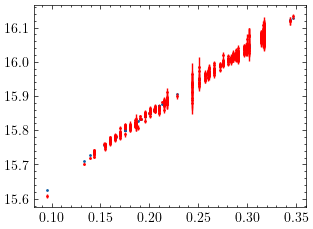

In [454]:
plt.errorbar(
    np.pi*np.array(indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["phaseAngle"].tolist())/180,
    indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["reducedMag"],
    yerr=indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["magErr"],
    fmt="o",
    markersize=1,
    color="r",
    label="Observed"
)

plt.scatter(
    np.pi*np.array(indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == results.iloc[0]["fname"])]["phaseAngle"].tolist())/180,
    x,
    s=1,
    label="Fitted"
)

In [455]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [456]:
data = indivObs.to_pandas()

In [460]:
mags = list(data[(data["ssObjectId"].isin(results[results["fname"] == "r"]["ssObjectId"])) & (data["band"] == "r")].groupby("ssObjectId")["reducedMag"].apply(np.array).values)
phases = list(data[(data["ssObjectId"].isin(results[results["fname"] == "r"]["ssObjectId"])) & (data["band"] == "r")].groupby("ssObjectId")["phaseAngle"].apply(np.array).values)
magErrs = data[(data["ssObjectId"].isin(results[results["fname"] == "r"]["ssObjectId"])) & (data["band"] == "r")].groupby("ssObjectId")["magErr"].apply(np.array).values

mag_len = len(mags)

for mag, err, phase in zip(mags, magErrs, phases):
    for i in range(100):
        phases.append(phase)
        mags.append(np.random.normal(mag, err))

In [464]:
N = 600

X_train, X_test, Y_train, Y_test = train_test_split(
   phases,
   mags,
   test_size=.1
)

In [465]:
model = RandomForestRegressor(
    n_estimators=100
)

model.fit(
    np.array([np.array(x[0:N]).reshape(-1, N) for x in X_train]).reshape(len(X_train), N),
    np.array([np.array(y[0:N]).reshape(-1, N) for y in Y_train]).reshape(len(Y_train), N)
)

RandomForestRegressor()

In [468]:
mean_squared_error(np.array([np.array(y[0:N]).reshape(-1, N) for y in Y_test]).reshape(len(Y_test), N), model.predict(
    np.array([np.array(x[0:N]).reshape(-1, N) for x in X_test]).reshape(len(X_test), N)))

0.0028089964815407953

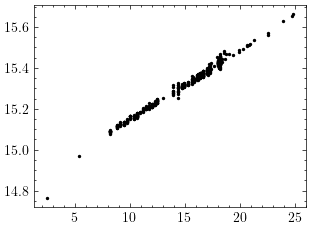

In [474]:
'''plt.errorbar(
    indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == "r")]["phaseAngle"].tolist(),
    indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == "r")]["reducedMag"],
    yerr=indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == "r")]["magErr"],
    fmt="o",
    markersize=1,
    color="r",
    label="Observed"
)
'''
plt.scatter(
    indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == "r")]["phaseAngle"].tolist()[0:N],
    model.predict(indivObs[(indivObs["ssObjectId"] == results.iloc[0]["ssObjectId"]) & (indivObs["band"] == "r")]["phaseAngle"][0:N].reshape(1,-1)).reshape(-1),
    s=2,
    c="black",
    label="Fitted"
)